Małgorzata Gierdewicz ID: 148264

#Superresolution

In [1]:
import kagglehub

path = kagglehub.dataset_download("saputrahas/dataset-image-super-resolution")

print("Path to dataset files:", path)

100%|██████████| 2.09G/2.09G [00:26<00:00, 84.1MB/s]

Extracting files...


Path to dataset files: /root/.cache/kagglehub/datasets/saputrahas/dataset-image-super-resolution/versions/1


First I will load images and process them so that there will be higher and lower resolution images of the same size

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import tensorflow as tf
import tensorflow_datasets as tfds
from tensorflow import keras
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.initializers import RandomNormal
from keras.layers import Conv2D, Conv2DTranspose, BatchNormalization, Dense, Flatten, Activation, LeakyReLU, ZeroPadding2D
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras import models
import os
import cv2

In [3]:
BASE_PATH = 'saputrahas/dataset-image-super-resolution/finished/'
TRAIN_PATH = 'finished/train/dataraw/hires/'
TEST_PATH = 'finished/valid/dataraw/hires/'
train_images = []
test_images = []

BATCH_SIZE = 64
W, H = (256, 256)

In [10]:
from PIL import Image
import os

def resize_and_degrade_images(input_folder, hr_folder, lr_folder, hr_size=(256, 256), scale_factor=2):

    if not os.path.exists(hr_folder):
        os.makedirs(hr_folder)
    if not os.path.exists(lr_folder):
        os.makedirs(lr_folder)

    lr_downscale_size = (hr_size[0] // scale_factor, hr_size[1] // scale_factor)

    for filename in os.listdir(input_folder):
        if filename.endswith(('.png', '.jpg', '.jpeg', '.bmp', '.gif')):

            img_path = os.path.join(input_folder, filename)
            img = Image.open(img_path)

            hr_img = img.resize(hr_size, Image.Resampling.LANCZOS)

            hr_output_path = os.path.join(hr_folder, filename)
            hr_img.save(hr_output_path)

            lr_img = hr_img.resize(lr_downscale_size, Image.Resampling.LANCZOS)
            lr_img = lr_img.resize(hr_size, Image.Resampling.LANCZOS)

            lr_output_path = os.path.join(lr_folder, filename)
            lr_img.save(lr_output_path)

In [2]:
# Example usage
input_folder = os.path.join(path, TRAIN_PATH)
hr_folder = '/content/drive/MyDrive/CV3_redo/train_resized/HR_train'
lr_folder = '/content/drive/MyDrive/CV3_redo/train_resized/LR_train'
resize_and_degrade_images(input_folder, hr_folder, lr_folder, hr_size=(256, 256), scale_factor=2)

NameError: name 'path' is not defined

#Image preprocessing

Normalization to [0,1] for SRCNN and EDSR

Overall I didn'rt manage to implement EDSR due to it being too computationally intensive. I stuck with basic SRCNN and tested additional loss functions and optimizers to see which one works the best. I also saved the ndarrays to not waste time and resources on loading all of images from the dataset.

In [11]:
import numpy as np
from PIL import Image
import os

def load_and_normalize_images(image_folder, max_images=1000, target_size=(256, 256)):
    images = []
    count = 0

    for filename in os.listdir(image_folder):
        if count >= max_images:
            break

        if filename.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.gif', '.tiff')):
            img = Image.open(os.path.join(image_folder, filename))

            if img.mode != 'RGB':
                img = img.convert('RGB')

            if img.size != target_size:
                img = img.resize(target_size, Image.Resampling.LANCZOS)

            img_array = np.array(img) / 255.0
            images.append(img_array)
            count += 1

    return np.array(images)

In [12]:
HR_image_folder = '/content/drive/MyDrive/CV3_redo/train_resized/HR_train'
HR_train_norm = load_and_normalize_images(HR_image_folder)
print(HR_train_norm.shape)

(1000, 256, 256, 3)


In [15]:
np.save('/content/drive/MyDrive/CV3_redo/train_resized/HR_array.npy', HR_train_norm)

In [16]:
LR_image_folder = '/content/drive/MyDrive/CV3_redo/train_resized/LR_train'
LR_train_norm = load_and_normalize_images(LR_image_folder)
print(LR_train_norm.shape)

(1000, 256, 256, 3)


In [17]:
np.save('/content/drive/MyDrive/CV3_redo/train_resized/LR_array.npy', LR_train_norm)

In [3]:
LR_train_norm = np.load('/content/drive/MyDrive/CV3_redo/train_resized/LR_array.npy')
HR_train_norm = np.load('/content/drive/MyDrive/CV3_redo/train_resized/HR_array.npy')

In [4]:
X_train = LR_train_norm[:800]
Y_train = HR_train_norm[:800]
X_test = LR_train_norm[800:]
Y_test = HR_train_norm[800:]

#SRCNN

I used the most basic SRCNN model. It consists of only 3 convolutional layers so that it's easier to train and doesn't crash my google colab. In the basic model I used adam optimizer and mse loss since they are the most popular optimizer and loss function for models overall. The color problem later in displaying the results is because My network worked, I forgot to add channels for colors but it worked, so I just assumed that's how it's supposed to be (until it wasn't, I couldn't enter arrays no matter what and realized that I had a mistake in my network, but I didn't have enough time to retrain other models)

In [6]:
import tensorflow as tf
from tensorflow.keras import layers, models

def SRCNN(input_shape=(None, None, 3)):
    inputs = layers.Input(shape=input_shape)

    x = layers.Conv2D(64, (9, 9), padding='same', activation='relu')(inputs)

    x = layers.Conv2D(32, (1, 1), padding='same', activation='relu')(x)

    outputs = layers.Conv2D(3, (5, 5), padding='same')(x)

    model = models.Model(inputs, outputs)
    return model


srcnn_model = SRCNN()
srcnn_model.compile(optimizer='adam', loss='mse')
srcnn_model.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, None, None, 3)       │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d (Conv2D)                      │ (None, None, None, 64)      │          15,616 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, None, None, 32)      │           2,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, None, None, 3)       │           2,403 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 20,099 (78.51 KB)

 Trainable params: 20,099 (78.51 KB)

 Non-trainable params: 0 (0.00 B)

In [14]:
from tensorflow.keras.models import load_model
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.callbacks import EarlyStopping, TensorBoard

checkpoint_callback_new = ModelCheckpoint(
    filepath='/content/drive/MyDrive/CV3_redo/models/SRCNN/sgd_srcnn_model_epoch_{epoch:02d}.keras',
    save_best_only=False,
    verbose=1
)


early_stopping = EarlyStopping(
    monitor='val_loss',
    patience=5,
    restore_best_weights=True
)

In [15]:
simple_srcnn = srcnn_model.fit(LR_train_norm, HR_train_norm, batch_size=16, epochs=10, verbose=1, callbacks=[checkpoint_callback_new, early_stopping], validation_split = 0.2)

Epoch 1/10
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 6s/step - loss: 0.0679
Epoch 1: saving model to /content/drive/MyDrive/CV3_redo/models/SRCNN/my_srcnn_model_epoch_01.keras
50/50 ━━━━━━━━━━━━━━━━━━━━ 331s 7s/step - loss: 0.0671 - val_loss: 0.0145
Epoch 2/10
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 6s/step - loss: 0.0128
Epoch 2: saving model to /content/drive/MyDrive/CV3_redo/models/SRCNN/my_srcnn_model_epoch_02.keras
50/50 ━━━━━━━━━━━━━━━━━━━━ 389s 7s/step - loss: 0.0128 - val_loss: 0.0118
Epoch 3/10
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 6s/step - loss: 0.0111
Epoch 3: saving model to /content/drive/MyDrive/CV3_redo/models/SRCNN/my_srcnn_model_epoch_03.keras
50/50 ━━━━━━━━━━━━━━━━━━━━ 376s 7s/step - loss: 0.0111 - val_loss: 0.0113
Epoch 4/10
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 6s/step - loss: 0.0104
Epoch 4: saving model to /content/drive/MyDrive/CV3_redo/models/SRCNN/my_srcnn_model_epoch_04.keras
50/50 ━━━━━━━━━━━━━━━━━━━━ 336s 7s/step - loss: 0.0104 - val_loss: 0.0110
Epoch 5/10
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 6s/step

In [16]:
srcnn_model.save('srcnn_model.keras')

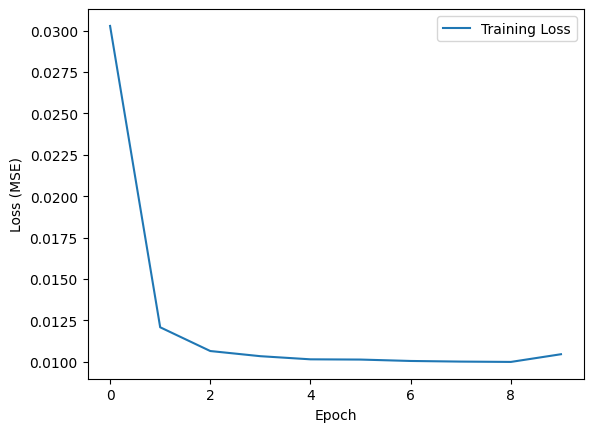

In [17]:
import matplotlib.pyplot as plt

plt.plot(simple_srcnn.history['loss'], label='Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss (MSE)')
plt.legend()
plt.show()

In [19]:
predictions = srcnn_model.predict(X_test)

accuracy = np.mean(predictions == Y_test)
print("Test Accuracy:", accuracy)

7/7 ━━━━━━━━━━━━━━━━━━━━ 19s 2s/step
Test Accuracy: 7.62939453125e-08


In [5]:
from tensorflow.keras.models import load_model
model = load_model('/content/drive/MyDrive/CV3_redo/models/SRCNN/my_srcnn_model_epoch_10.keras')

In [5]:
import tensorflow as tf

import numpy as np
from PIL import Image
import matplotlib.pyplot as plt


def display_predictions(model, num_samples):
    """
    Displays LR images, predicted HR images, and ground truth HR images.

    Args:
        model: Trained SRCNN model.
        lr_image_paths (list): List of paths to low-resolution images.
        hr_image_paths (list): List of paths to high-resolution images.
        num_samples (int): Number of samples to display.
    """
    plt.figure(figsize=(15, 5 * num_samples))

    for i in range(num_samples):

        predicted_hr_image = model.predict(np.expand_dims(X_test[i], axis=0))[0]

        predicted_hr_image = np.clip(predicted_hr_image, 0, 1)

        plt.subplot(num_samples, 3, i * 3 + 1)
        plt.imshow(X_test[i])
        plt.title('Low-Resolution Image')
        plt.axis('off')

        plt.subplot(num_samples, 3, i * 3 + 2)
        plt.imshow(predicted_hr_image)
        plt.title('Predicted High-Resolution Image')
        plt.axis('off')

        plt.subplot(num_samples, 3, i * 3 + 3)
        plt.imshow(Y_test[i])
        plt.title('Ground Truth High-Resolution Image')
        plt.axis('off')

    plt.tight_layout()
    plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


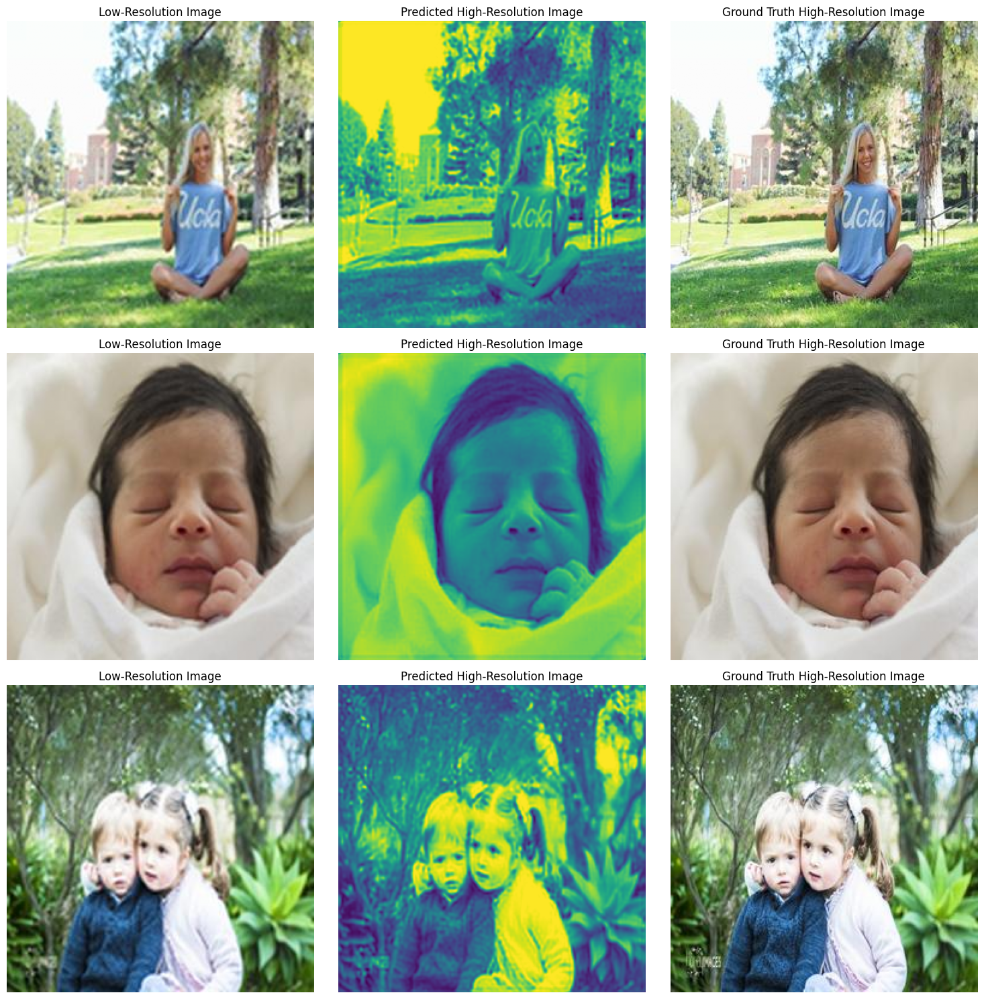

In [17]:
display_predictions(model,num_samples=3)


#Testing other optimizers

In this section I chose 2 optimizers that would perform good on superresolution task and 1 that generally doesn't perform as good:
- adadelta is robust to noisy gradients and works well for super-resolution tasks where the optimization landscape can be complex.
- nadam often converges faster and is suitable for super-resolution tasks where fine-grained details need to be recovered.
- sgd is not the best but is one of the easiest optimizer to implement since it's straightforward and doesn't have additional hyperparameters. It's mauin downside for superresolution problem is that it can converge much slower than other algorithms.

In [18]:
optimizer_adadelta = tf.keras.optimizers.Adadelta(learning_rate=1.0, rho=0.9)
optimizer_nadam = tf.keras.optimizers.Nadam(learning_rate=0.001)

In [21]:
srcnn_adadelta_model = SRCNN()
srcnn_adadelta_model.compile(optimizer=optimizer_adadelta, loss='mse')
srcnn_model.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, None, None, 3)       │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d (Conv2D)                      │ (None, None, None, 64)      │          15,616 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, None, None, 32)      │           2,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, None, None, 1)       │             801 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 18,497 (72.25 KB)

 Trainable params: 18,497 (72.25 KB)

 Non-trainable params: 0 (0.00 B)

In [23]:
srcnn_adadelta = srcnn_adadelta_model.fit(X_train, Y_train, batch_size=16, epochs=10, verbose=1, callbacks=[checkpoint_callback_new, early_stopping], validation_split = 0.2)

Epoch 1/10
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 8s/step - loss: 0.0490
Epoch 1: saving model to /content/drive/MyDrive/CV3_redo/models/SRCNN/adadelta_srcnn_model_epoch_01.keras
40/40 ━━━━━━━━━━━━━━━━━━━━ 332s 8s/step - loss: 0.0485 - val_loss: 0.0296
Epoch 2/10
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 8s/step - loss: 0.0268
Epoch 2: saving model to /content/drive/MyDrive/CV3_redo/models/SRCNN/adadelta_srcnn_model_epoch_02.keras
40/40 ━━━━━━━━━━━━━━━━━━━━ 388s 8s/step - loss: 0.0268 - val_loss: 0.0184
Epoch 3/10
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 8s/step - loss: 0.0208
Epoch 3: saving model to /content/drive/MyDrive/CV3_redo/models/SRCNN/adadelta_srcnn_model_epoch_03.keras
40/40 ━━━━━━━━━━━━━━━━━━━━ 377s 8s/step - loss: 0.0208 - val_loss: 0.0190
Epoch 4/10
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 8s/step - loss: 0.0203
Epoch 4: saving model to /content/drive/MyDrive/CV3_redo/models/SRCNN/adadelta_srcnn_model_epoch_04.keras
40/40 ━━━━━━━━━━━━━━━━━━━━ 383s 8s/step - loss: 0.0203 - val_loss: 0.0134
Epoch 5/10
40/40 ━━━━━━━

In [24]:
predictions = srcnn_adadelta_model.predict(X_test)

accuracy = np.mean(predictions == Y_test)
print("Test Accuracy:", accuracy)

7/7 ━━━━━━━━━━━━━━━━━━━━ 21s 3s/step
Test Accuracy: 0.0


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


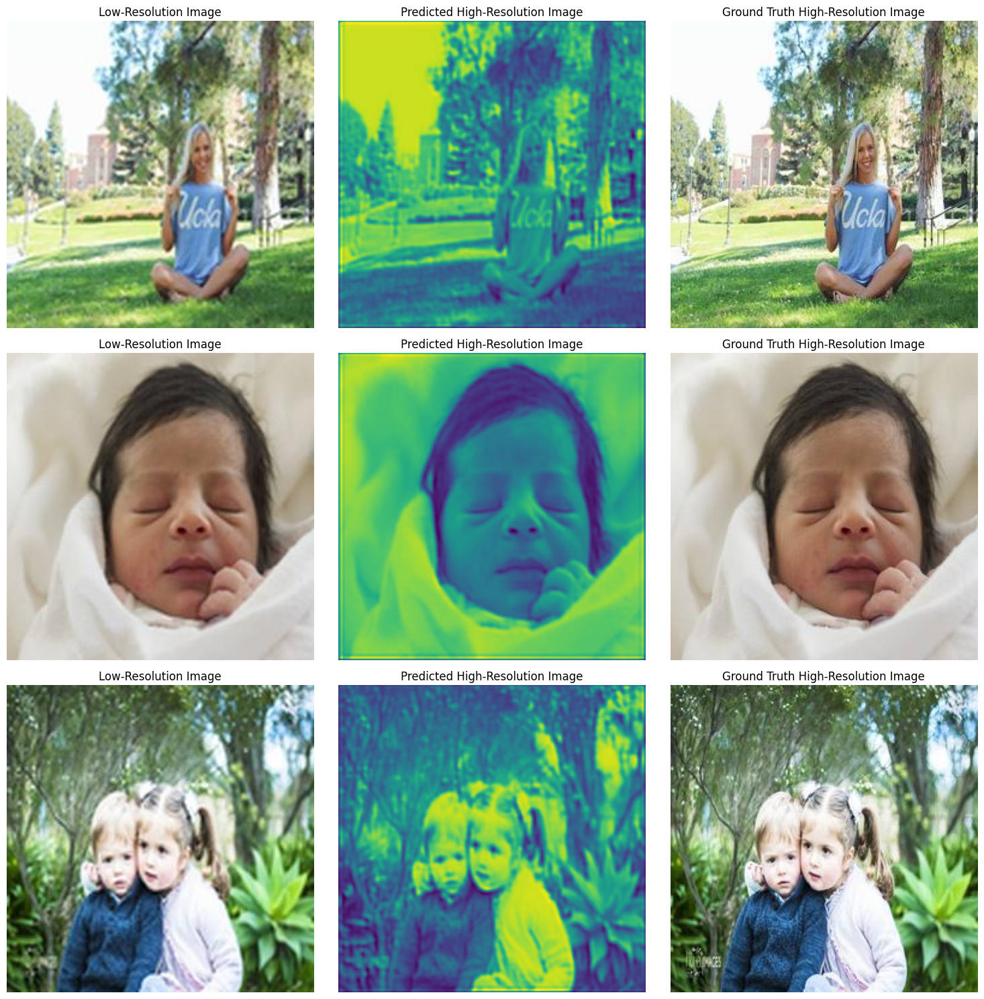

In [25]:
display_predictions(srcnn_adadelta_model,num_samples=3)

In [33]:
srcnn_nadam_model = SRCNN()
srcnn_nadam_model.compile(optimizer=optimizer_nadam, loss='mse')
srcnn_nadam_model.summary()

Model: "functional_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_4 (InputLayer)           │ (None, None, None, 3)       │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_12 (Conv2D)                   │ (None, None, None, 64)      │          15,616 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_13 (Conv2D)                   │ (None, None, None, 32)      │           2,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_14 (Conv2D)                   │ (None, None, None, 1)       │             801 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 55,494 (216.78 KB)

 Trainable params: 18,497 (72.25 KB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 36,997 (144.52 KB)

In [37]:
tf.compat.v1.enable_eager_execution()
srcnn_nadam = srcnn_nadam_model.fit(X_train, Y_train, batch_size=16, epochs=10, verbose=1, callbacks=[checkpoint_callback_new, early_stopping], validation_split = 0.2)

Epoch 1/10


NotImplementedError: numpy() is only available when eager execution is enabled.

In [6]:
srcnn_nadam = load_model('/content/drive/MyDrive/CV3_redo/models/SRCNN/nadam_srcnn_model_epoch_10.keras')

In [7]:
predictions = srcnn_nadam.predict(X_test)

accuracy = np.mean(predictions == Y_test)
print("Test Accuracy:", accuracy)

7/7 ━━━━━━━━━━━━━━━━━━━━ 23s 3s/step
Test Accuracy: 0.0


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


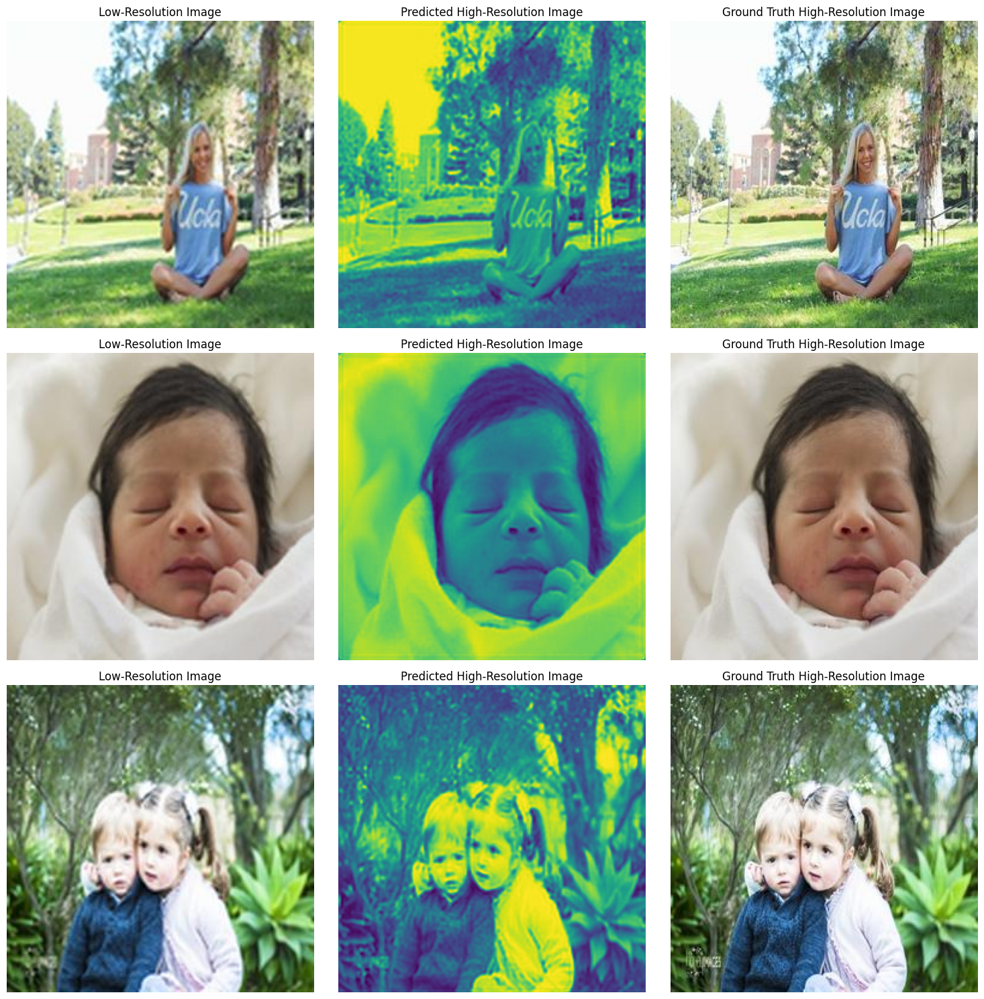

In [10]:
display_predictions(srcnn_nadam,num_samples=3)

In [13]:
srcnn_sgd_model = SRCNN()
srcnn_sgd_model.compile(optimizer=tf.keras.optimizers.SGD(learning_rate=0.01, momentum=0.9), loss='mse')
srcnn_sgd_model.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)           │ (None, None, None, 3)       │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_3 (Conv2D)                    │ (None, None, None, 64)      │          15,616 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_4 (Conv2D)                    │ (None, None, None, 32)      │           2,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_5 (Conv2D)                    │ (None, None, None, 1)       │             801 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 18,497 (72.25 KB)

 Trainable params: 18,497 (72.25 KB)

 Non-trainable params: 0 (0.00 B)

In [15]:
srcnn_sgd = srcnn_sgd_model.fit(X_train, Y_train, batch_size=16, epochs=10, verbose=1, callbacks=[checkpoint_callback_new, early_stopping], validation_split = 0.2)

Epoch 1/10
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 8s/step - loss: 0.0481
Epoch 1: saving model to /content/drive/MyDrive/CV3_redo/models/SRCNN/sgd_srcnn_model_epoch_01.keras
40/40 ━━━━━━━━━━━━━━━━━━━━ 342s 9s/step - loss: 0.0476 - val_loss: 0.0140
Epoch 2/10
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 8s/step - loss: 0.0138
Epoch 2: saving model to /content/drive/MyDrive/CV3_redo/models/SRCNN/sgd_srcnn_model_epoch_02.keras
40/40 ━━━━━━━━━━━━━━━━━━━━ 371s 8s/step - loss: 0.0138 - val_loss: 0.0122
Epoch 3/10
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 7s/step - loss: 0.0127
Epoch 3: saving model to /content/drive/MyDrive/CV3_redo/models/SRCNN/sgd_srcnn_model_epoch_03.keras
40/40 ━━━━━━━━━━━━━━━━━━━━ 342s 9s/step - loss: 0.0127 - val_loss: 0.0114
Epoch 4/10
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 8s/step - loss: 0.0109
Epoch 4: saving model to /content/drive/MyDrive/CV3_redo/models/SRCNN/sgd_srcnn_model_epoch_04.keras
40/40 ━━━━━━━━━━━━━━━━━━━━ 325s 8s/step - loss: 0.0109 - val_loss: 0.0110
Epoch 5/10
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 8s/

In [18]:
predictions = srcnn_sgd_model.predict(X_test)

accuracy = np.mean(predictions == Y_test)
print("Test Accuracy:", accuracy)

7/7 ━━━━━━━━━━━━━━━━━━━━ 19s 3s/step
Test Accuracy: 0.0


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


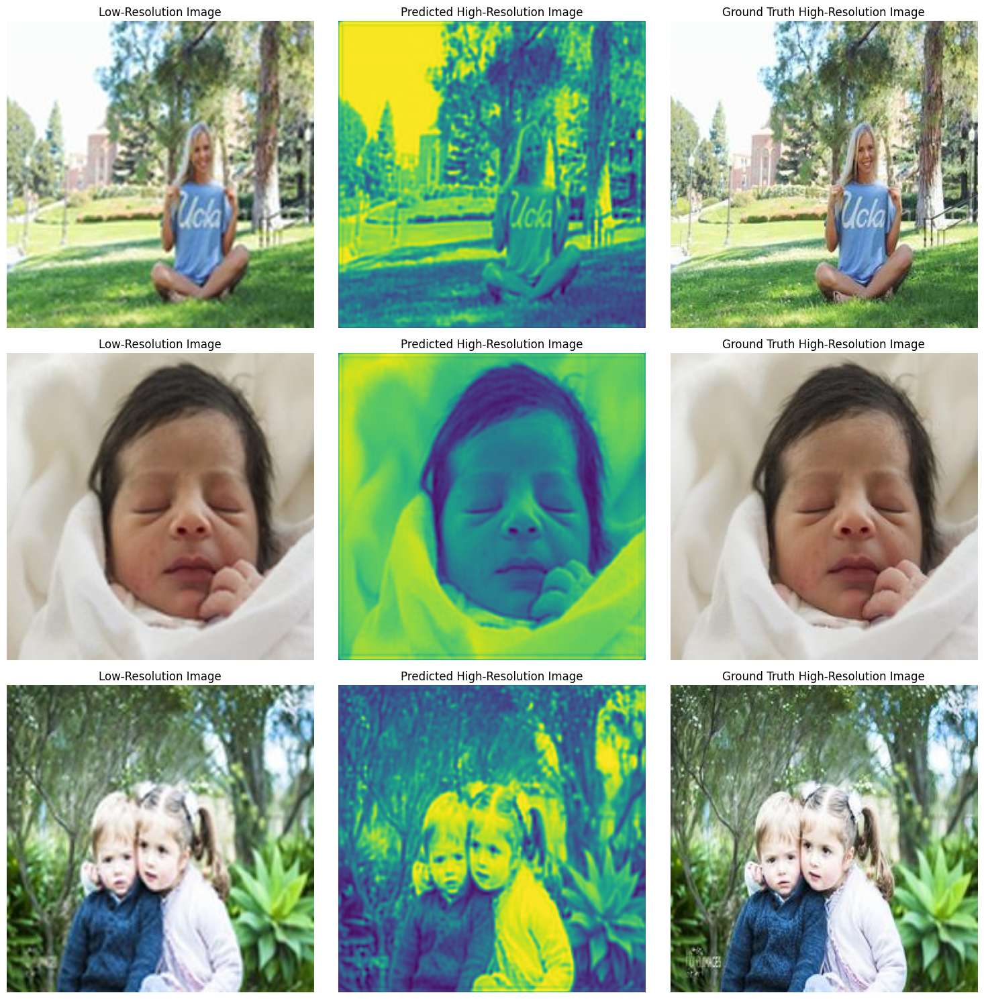

In [20]:
display_predictions(srcnn_sgd_model,num_samples=3)

#Overfitting training data

I tried to overfit the training data to see how much it impacts the ability of my simple network to learn even if I don't have much of different data.

In [6]:
srcnn_model = SRCNN()
srcnn_model.compile(optimizer='adam', loss='mse')
srcnn_model.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)           │ (None, None, None, 3)       │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_3 (Conv2D)                    │ (None, None, None, 64)      │          15,616 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_4 (Conv2D)                    │ (None, None, None, 32)      │           2,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_5 (Conv2D)                    │ (None, None, None, 1)       │             801 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 18,497 (72.25 KB)

 Trainable params: 18,497 (72.25 KB)

 Non-trainable params: 0 (0.00 B)

In [7]:
from tensorflow.keras.models import load_model
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.callbacks import EarlyStopping, TensorBoard

checkpoint_callback_overfit = ModelCheckpoint(
    filepath='/content/drive/MyDrive/CV3_redo/models/SRCNN/OVERFIT_model_epoch_{epoch:02d}.keras',
    save_best_only=False,
    verbose=1
)


early_stopping = EarlyStopping(
    monitor='val_loss',
    patience=2,
    restore_best_weights=True
)

In [8]:
X_train_overfit = [X_train[:100] for i in range(10)]
Y_train_overfit = [Y_train[:100] for i in range(10)]

X_train_overfit = np.concatenate(X_train_overfit)
Y_train_overfit = np.concatenate(Y_train_overfit)

In [ ]:
OVERFIT_SRCNN = srcnn_model.fit(X_train_overfit, Y_train_overfit, batch_size=16, epochs=10, verbose=1, callbacks=[checkpoint_callback_overfit, early_stopping], validation_split = 0.2)

Epoch 1/10
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 8s/step - loss: 0.0456
Epoch 1: saving model to /content/drive/MyDrive/CV3_redo/models/SRCNN/OVERFIT_model_epoch_01.keras
50/50 ━━━━━━━━━━━━━━━━━━━━ 428s 9s/step - loss: 0.0451 - val_loss: 0.0131
Epoch 2/10
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 8s/step - loss: 0.0126
Epoch 2: saving model to /content/drive/MyDrive/CV3_redo/models/SRCNN/OVERFIT_model_epoch_02.keras
50/50 ━━━━━━━━━━━━━━━━━━━━ 420s 8s/step - loss: 0.0126 - val_loss: 0.0108
Epoch 3/10
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 8s/step - loss: 0.0108
Epoch 3: saving model to /content/drive/MyDrive/CV3_redo/models/SRCNN/OVERFIT_model_epoch_03.keras
50/50 ━━━━━━━━━━━━━━━━━━━━ 460s 8s/step - loss: 0.0108 - val_loss: 0.0101
Epoch 4/10
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 7s/step - loss: 0.0100
Epoch 4: saving model to /content/drive/MyDrive/CV3_redo/models/SRCNN/OVERFIT_model_epoch_04.keras
50/50 ━━━━━━━━━━━━━━━━━━━━ 413s 8s/step - loss: 0.0100 - val_loss: 0.0099
Epoch 5/10
13/50 ━━━━━━━━━━━━━━━━━━━━ 4:37 7s/step -

In [9]:
overfit_srcnn = load_model('/content/drive/MyDrive/CV3_redo/models/SRCNN/OVERFIT_model_epoch_07.keras')

In [10]:
OVERFIT_SRCNN_CONT = overfit_srcnn.fit(X_train_overfit, Y_train_overfit, batch_size=16, epochs=3, verbose=1, callbacks=[checkpoint_callback_overfit, early_stopping], validation_split = 0.2)

Epoch 1/3
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - loss: 0.0102
Epoch 1: saving model to /content/drive/MyDrive/CV3_redo/models/SRCNN/OVERFIT_model_epoch_01.keras
50/50 ━━━━━━━━━━━━━━━━━━━━ 190s 4s/step - loss: 0.0102 - val_loss: 0.0097
Epoch 2/3
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - loss: 0.0097
Epoch 2: saving model to /content/drive/MyDrive/CV3_redo/models/SRCNN/OVERFIT_model_epoch_02.keras
50/50 ━━━━━━━━━━━━━━━━━━━━ 201s 4s/step - loss: 0.0097 - val_loss: 0.0097
Epoch 3/3
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - loss: 0.0103
Epoch 3: saving model to /content/drive/MyDrive/CV3_redo/models/SRCNN/OVERFIT_model_epoch_03.keras
50/50 ━━━━━━━━━━━━━━━━━━━━ 187s 4s/step - loss: 0.0103 - val_loss: 0.0097


In [12]:
predictions = overfit_srcnn.predict(X_test)

accuracy = np.mean(predictions == Y_test)
print("Test Accuracy:", accuracy)

7/7 ━━━━━━━━━━━━━━━━━━━━ 11s 2s/step
Test Accuracy: 0.0


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


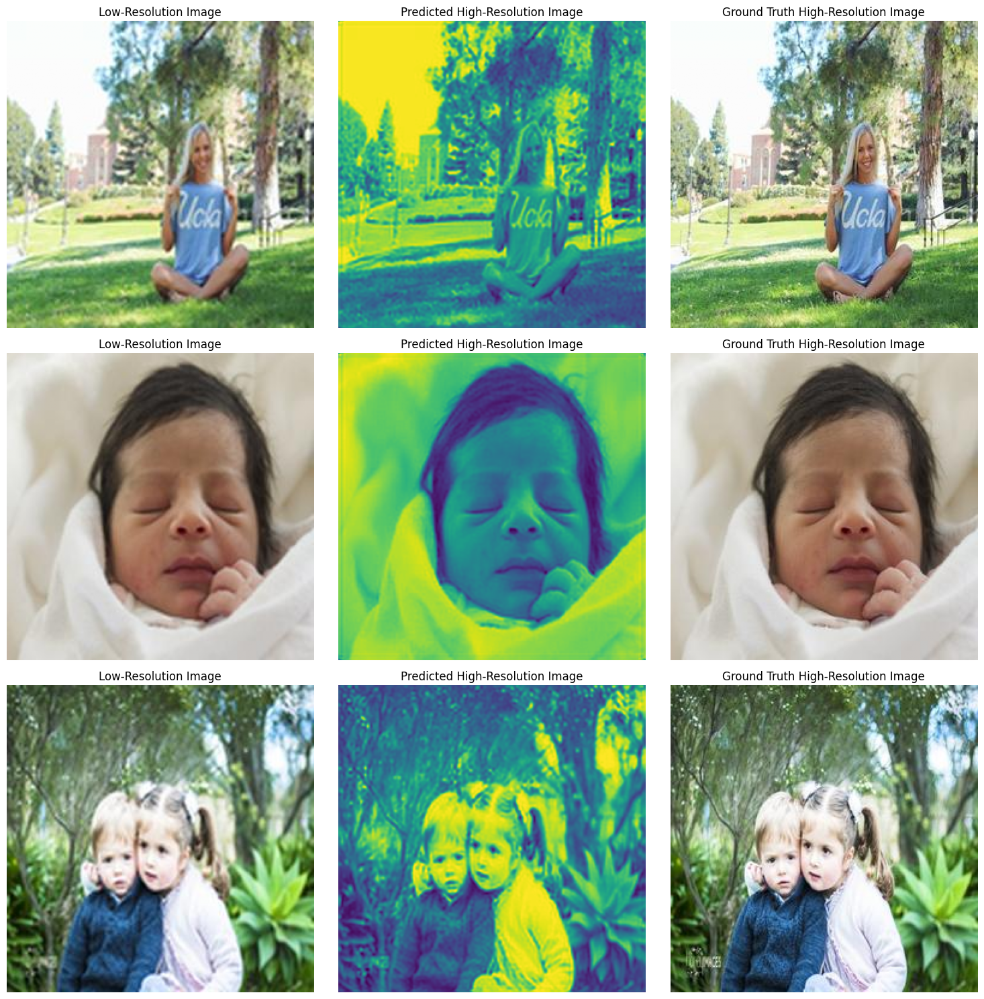

In [14]:
display_predictions(overfit_srcnn,num_samples=3)

#Testing other loss functions

Since most of my results came out of very simple network, I tried different loss functions to check whether they will improve my model. I used the following loss functions:
- perceptual loss - helps the network focus on recovering perceptually important details.
- Charbonnier loss -  used in super-resolution tasks to handle noise and artifacts in the reconstructed images.
- SSIM loss -  focuses on preserving luminance, contrast, and structure, making it suitable for super-resolution tasks.

Overall the Charbonnier loss and SSIM loss were trained on much slower number of epochs to savew time and resources, thus why the comparison of them with perceptual loss that gave out the best images may not be the most reliable.

In [8]:
import tensorflow as tf
from tensorflow.keras.applications import VGG16

def perceptual_loss(y_true, y_pred):
    vgg = VGG16(include_top=False, weights='imagenet', input_shape=(None, None, 3))
    vgg.trainable = False
    y_true_features = vgg(y_true)
    y_pred_features = vgg(y_pred)
    return tf.reduce_mean(tf.square(y_true_features - y_pred_features))

def charbonnier_loss(y_true, y_pred, eps=1e-3):
    return tf.reduce_mean(tf.sqrt(tf.square(y_true - y_pred) + eps**2))

def ssim_loss(y_true, y_pred):
    return 1 - tf.reduce_mean(tf.image.ssim(y_true, y_pred, max_val=1.0))


In [8]:
import tensorflow as tf
from tensorflow.keras.applications import VGG16

class PerceptualLoss(tf.keras.losses.Loss):
    def __init__(self):
        super(PerceptualLoss, self).__init__()
        self.vgg = VGG16(include_top=False, weights='imagenet', input_shape=(None, None, 3))
        self.vgg.trainable = False


    def call(self, y_true, y_pred):
        y_true_features = self.vgg(y_true)
        y_pred_features = self.vgg(y_pred)
        return tf.reduce_mean(tf.square(y_true_features - y_pred_features))

class CharbonnierLoss(tf.keras.losses.Loss):
    def __init__(self, eps=1e-3):
        super(CharbonnierLoss, self).__init__()
        self.eps = eps

    def call(self, y_true, y_pred):
        return tf.reduce_mean(tf.sqrt(tf.square(y_true - y_pred) + self.eps**2))


class SSIMLoss(tf.keras.losses.Loss):
    def call(self, y_true, y_pred):
        return 1 - tf.reduce_mean(tf.image.ssim(y_true, y_pred, max_val=1.0))

In [9]:
perceptual_loss = PerceptualLoss()
p_loss_srcnn_model = SRCNN()
p_loss_srcnn_model.compile(optimizer='adam', loss=perceptual_loss)
p_loss_srcnn_model.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_2 (InputLayer)           │ (None, None, None, 3)       │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_3 (Conv2D)                    │ (None, None, None, 64)      │          15,616 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_4 (Conv2D)                    │ (None, None, None, 32)      │           2,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_5 (Conv2D)                    │ (None, None, None, 3)       │           2,403 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 20,099 (78.51 KB)

 Trainable params: 20,099 (78.51 KB)

 Non-trainable params: 0 (0.00 B)

In [10]:
from tensorflow.keras.models import load_model
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.callbacks import EarlyStopping, TensorBoard

checkpoint_callback_new = ModelCheckpoint(
    filepath='/content/drive/MyDrive/CV3_redo/models/SRCNN/p_loss_model_epoch_{epoch:02d}.keras',
    save_best_only=False,
    verbose=1
)


early_stopping = EarlyStopping(
    monitor='val_loss',
    patience=5,
    restore_best_weights=True
)

In [11]:
perceptual = p_loss_srcnn_model.fit(X_train, Y_train, batch_size=16, epochs=10, verbose=1, callbacks=[checkpoint_callback_new, early_stopping], validation_split = 0.2)

Epoch 1/10
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 29s/step - loss: 0.0569 
Epoch 1: saving model to /content/drive/MyDrive/CV3_redo/models/SRCNN/p_loss_model_epoch_01.keras
40/40 ━━━━━━━━━━━━━━━━━━━━ 1351s 34s/step - loss: 0.0567 - val_loss: 0.0409
Epoch 2/10
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 29s/step - loss: 0.0379 
Epoch 2: saving model to /content/drive/MyDrive/CV3_redo/models/SRCNN/p_loss_model_epoch_02.keras
40/40 ━━━━━━━━━━━━━━━━━━━━ 1351s 34s/step - loss: 0.0378 - val_loss: 0.0236
Epoch 3/10
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 29s/step - loss: 0.0164 
Epoch 3: saving model to /content/drive/MyDrive/CV3_redo/models/SRCNN/p_loss_model_epoch_03.keras
40/40 ━━━━━━━━━━━━━━━━━━━━ 1397s 34s/step - loss: 0.0163 - val_loss: 0.0091
Epoch 4/10
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 28s/step - loss: 0.0083 
Epoch 4: saving model to /content/drive/MyDrive/CV3_redo/models/SRCNN/p_loss_model_epoch_04.keras
40/40 ━━━━━━━━━━━━━━━━━━━━ 1397s 34s/step - loss: 0.0083 - val_loss: 0.0077
Epoch 5/10
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s

In [22]:
predictions = p_loss_srcnn_model.predict(X_test)

accuracy = np.mean(predictions == Y_test)
print("Test Accuracy:", accuracy)

7/7 ━━━━━━━━━━━━━━━━━━━━ 15s 2s/step
Test Accuracy: 2.5431315104166668e-08


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


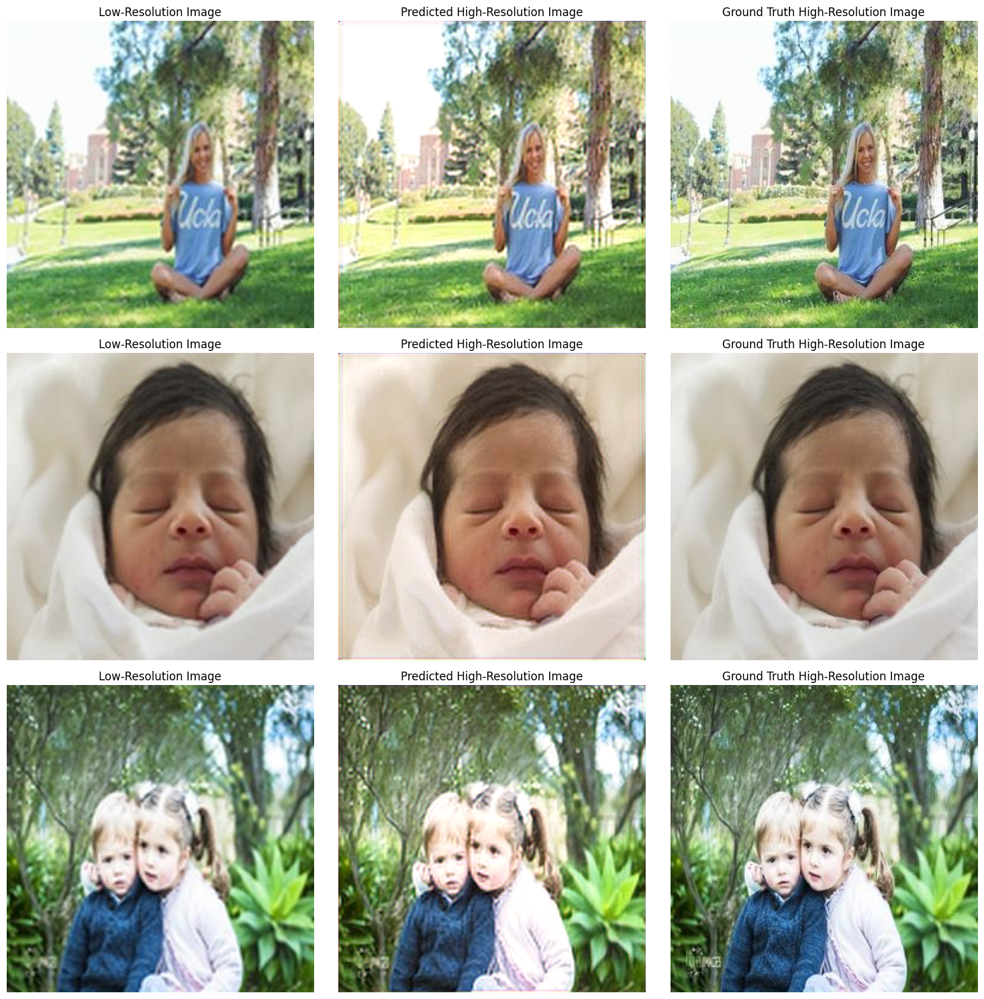

In [13]:
display_predictions(p_loss_srcnn_model,num_samples=3)

In [19]:
CharbonnierLoss = CharbonnierLoss()
charbonnier_loss_model = SRCNN()
charbonnier_loss_model.compile(optimizer= 'adam', loss = CharbonnierLoss)
charbonnier_loss_model.summary()

Model: "functional_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_5 (InputLayer)           │ (None, None, None, 3)       │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_12 (Conv2D)                   │ (None, None, None, 64)      │          15,616 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_13 (Conv2D)                   │ (None, None, None, 32)      │           2,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_14 (Conv2D)                   │ (None, None, None, 3)       │           2,403 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 20,099 (78.51 KB)

 Trainable params: 20,099 (78.51 KB)

 Non-trainable params: 0 (0.00 B)

In [20]:
from tensorflow.keras.models import load_model
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.callbacks import EarlyStopping, TensorBoard

checkpoint_callback_new = ModelCheckpoint(
    filepath='/content/drive/MyDrive/CV3_redo/models/SRCNN/charbonnier_loss_model_epoch_{epoch:02d}.keras',
    save_best_only=False,
    verbose=1
)


early_stopping = EarlyStopping(
    monitor='val_loss',
    patience=5,
    restore_best_weights=True
)

In [21]:
charbonnier = charbonnier_loss_model.fit(X_train, Y_train, batch_size=16, epochs=5, verbose=1, callbacks=[checkpoint_callback_new, early_stopping], validation_split = 0.2)

Epoch 1/5
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 4s/step - loss: 0.1517
Epoch 1: saving model to /content/drive/MyDrive/CV3_redo/models/SRCNN/charbonnier_loss_model_epoch_01.keras
40/40 ━━━━━━━━━━━━━━━━━━━━ 160s 4s/step - loss: 0.1503 - val_loss: 0.0535
Epoch 2/5
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 4s/step - loss: 0.0524
Epoch 2: saving model to /content/drive/MyDrive/CV3_redo/models/SRCNN/charbonnier_loss_model_epoch_02.keras
40/40 ━━━━━━━━━━━━━━━━━━━━ 205s 4s/step - loss: 0.0524 - val_loss: 0.0537
Epoch 3/5
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 4s/step - loss: 0.0479
Epoch 3: saving model to /content/drive/MyDrive/CV3_redo/models/SRCNN/charbonnier_loss_model_epoch_03.keras
40/40 ━━━━━━━━━━━━━━━━━━━━ 198s 4s/step - loss: 0.0479 - val_loss: 0.0427
Epoch 4/5
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 4s/step - loss: 0.0439
Epoch 4: saving model to /content/drive/MyDrive/CV3_redo/models/SRCNN/charbonnier_loss_model_epoch_04.keras
40/40 ━━━━━━━━━━━━━━━━━━━━ 211s 4s/step - loss: 0.0439 - val_loss: 0.0418
Epoch 5/5
40/40 ━━━━

In [23]:
predictions = charbonnier_loss_model.predict(X_test)

accuracy = np.mean(predictions == Y_test)
print("Test Accuracy:", accuracy)

7/7 ━━━━━━━━━━━━━━━━━━━━ 14s 2s/step
Test Accuracy: 0.0


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


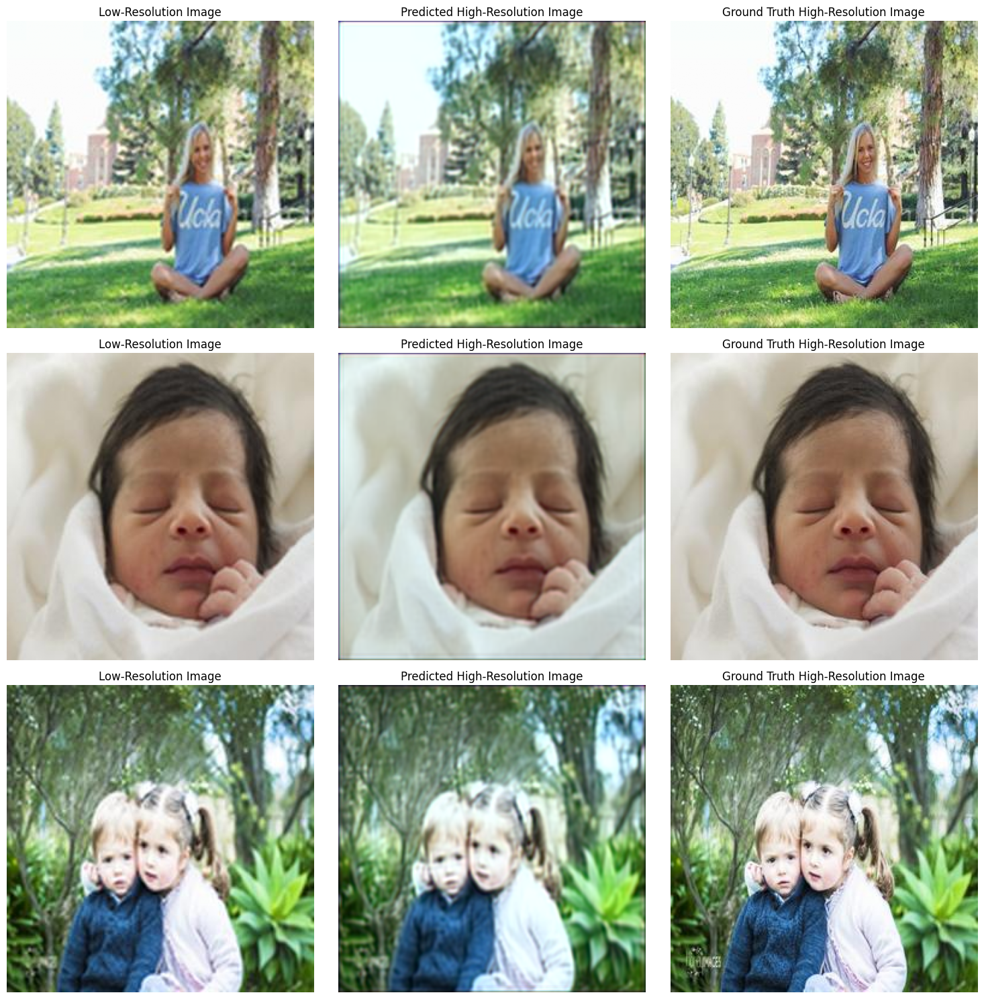

In [24]:
display_predictions(charbonnier_loss_model,num_samples=3)

In [25]:
ssim_loss = SSIMLoss()
ssim_loss_model = SRCNN()
ssim_loss_model.compile(optimizer='adam', loss=ssim_loss)
ssim_loss_model.summary()

Model: "functional_5"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_6 (InputLayer)           │ (None, None, None, 3)       │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_15 (Conv2D)                   │ (None, None, None, 64)      │          15,616 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_16 (Conv2D)                   │ (None, None, None, 32)      │           2,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_17 (Conv2D)                   │ (None, None, None, 3)       │           2,403 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 20,099 (78.51 KB)

 Trainable params: 20,099 (78.51 KB)

 Non-trainable params: 0 (0.00 B)

In [26]:
from tensorflow.keras.models import load_model
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.callbacks import EarlyStopping, TensorBoard

checkpoint_callback_new = ModelCheckpoint(
    filepath='/content/drive/MyDrive/CV3_redo/models/SRCNN/ssim_loss_model_epoch_{epoch:02d}.keras',
    save_best_only=False,
    verbose=1
)


early_stopping = EarlyStopping(
    monitor='val_loss',
    patience=2,
    restore_best_weights=True
)

In [27]:
ssim = ssim_loss_model.fit(X_train, Y_train, batch_size=16, epochs=5, verbose=1, callbacks=[checkpoint_callback_new, early_stopping], validation_split = 0.2)

Epoch 1/5
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 9s/step - loss: 0.4508
Epoch 1: saving model to /content/drive/MyDrive/CV3_redo/models/SRCNN/ssim_loss_model_epoch_01.keras
40/40 ━━━━━━━━━━━━━━━━━━━━ 384s 10s/step - loss: 0.4471 - val_loss: 0.1662
Epoch 2/5
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 9s/step - loss: 0.1567
Epoch 2: saving model to /content/drive/MyDrive/CV3_redo/models/SRCNN/ssim_loss_model_epoch_02.keras
40/40 ━━━━━━━━━━━━━━━━━━━━ 441s 10s/step - loss: 0.1565 - val_loss: 0.1429
Epoch 3/5
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 9s/step - loss: 0.1383
Epoch 3: saving model to /content/drive/MyDrive/CV3_redo/models/SRCNN/ssim_loss_model_epoch_03.keras
40/40 ━━━━━━━━━━━━━━━━━━━━ 442s 10s/step - loss: 0.1385 - val_loss: 0.1447
Epoch 4/5
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 9s/step - loss: 0.1438
Epoch 4: saving model to /content/drive/MyDrive/CV3_redo/models/SRCNN/ssim_loss_model_epoch_04.keras
40/40 ━━━━━━━━━━━━━━━━━━━━ 439s 10s/step - loss: 0.1437 - val_loss: 0.1329
Epoch 5/5
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 9s/s

In [ ]:
srcnn_model = SRCNN()
srcnn_model.compile(optimizer='adam', loss='mse')
srcnn_model.summary()

#EDSR

In [4]:
import tensorflow as tf
from tensorflow.keras import layers, models

def residual_block(x, filters):
    res = layers.Conv2D(filters, (3, 3), padding='same', activation='relu')(x)
    res = layers.Conv2D(filters, (3, 3), padding='same')(res)
    return layers.Add()([x, res])

def EDSR(input_shape=(None, None, 3), num_res_blocks=16, filters=256):
    inputs = layers.Input(shape=input_shape)

    # Initial convolution
    x = layers.Conv2D(filters, (3, 3), padding='same')(inputs)

    # Residual blocks
    for _ in range(num_res_blocks):
        x = residual_block(x, filters)

    # Final convolution
    x = layers.Conv2D(filters, (3, 3), padding='same')(x)
    outputs = layers.Conv2D(3, (3, 3), padding='same')(x)

    model = models.Model(inputs, outputs)
    return model

# Compile the model
edsr_model = EDSR()
edsr_model.compile(optimizer='adam', loss='mse')
edsr_model.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, None, None, 3)  │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d (Conv2D)           │ (None, None, None,     │          7,168 │ input_layer[0][0]      │
│                           │ 256)                   │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_1 (Conv2D)         │ (None, None, None,     │        590,080 │ conv2d[0][0]           │
│                           │ 256)                   │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_2 (Conv2D)         │ (None, None, None,     │        590,080 │ conv2d_1[0][0]         │
│                           │ 256)                   │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ add (Add)                 │ (None, None, None,     │              0 │ conv2d[0][0],          │
│                           │ 256)                   │                │ conv2d_2[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_3 (Conv2D)         │ (None, None, None,     │        590,080 │ add[0][0]              │
│                           │ 256)                   │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_4 (Conv2D)         │ (None, None, None,     │        590,080 │ conv2d_3[0][0]         │
│                           │ 256)                   │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ add_1 (Add)               │ (None, None, None,     │              0 │ add[0][0],             │
│                           │ 256)                   │                │ conv2d_4[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_5 (Conv2D)         │ (None, None, None,     │        590,080 │ add_1[0][0]            │
│                           │ 256)                   │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_6 (Conv2D)         │ (None, None, None,     │        590,080 │ conv2d_5[0][0]         │
│                           │ 256)                   │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ add_2 (Add)               │ (None, None, None,     │              0 │ add_1[0][0],           │
│                           │ 256)                   │                │ conv2d_6[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_7 (Conv2D)         │ (None, None, None,     │        590,080 │ add_2[0][0]            │
│                           │ 256)                   │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_8 (Conv2D)         │ (None, None, None,     │        590,080 │ conv2d_7[0][0]         │
│                           │ 256)                   │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ add_3 (Add)          

 Total params: 19,486,723 (74.34 MB)

 Trainable params: 19,486,723 (74.34 MB)

 Non-trainable params: 0 (0.00 B)

In [5]:
from tensorflow.keras.models import load_model
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.callbacks import EarlyStopping, TensorBoard

checkpoint_callback_edsr = ModelCheckpoint(
    filepath='/content/drive/MyDrive/CV3_redo/models/EDSR/my_edsr_model_epoch_{epoch:02d}.keras',
    save_best_only=False,
    verbose=1
)


early_stopping = EarlyStopping(
    monitor='val_loss',
    patience=5,  # Stop after 5 epochs without improvement
    restore_best_weights=True
)

In [ ]:
edsr = edsr_model.fit(LR_train_norm, HR_train_norm, epochs=10, verbose=1, callbacks=[checkpoint_callback_edsr, early_stopping])

Epoch 1/10
